# Whiteboard also-rans

These are scraps from [the Whiteboarder project](https://github.com/JohnTigue/whiteboarder). These are tools that worked – on a code level – but were superceded by more sophisticated UI and code. None-the-less they worked, so they were kept. Another corollary of the Whiteboarder work is eight_bit_gauges.ipynb, which contains tons of UI widgets for plotting histograms of unit8s. The Eight Bit Gauges are a fully reusable, importable Python package, whereas herein the gauges are used but the result tools are essentially deprecated, unless some other use arrises

In [0]:
import cv2
import google.colab

import ipywidgets
from ipywidgets import Button, Layout, interact, interactive

import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import requests
import skimage.color 
import skimage.exposure
import skimage.io
from skimage.util import img_as_ubyte, img_as_float
from IPython.display import display

import bokeh.io
import bokeh.layouts
from bokeh.models import ColumnDataSource, Step
from bokeh.models import LinearAxis, Range1d
import bokeh.plotting

from google.colab.data_table import DataTable
import google.colab.widgets

## Setup

In [0]:
# This needs to be called once per notebook, otherwise Bokeh plots fail silently.
bokeh.io.output_notebook()

### Sample data

In [3]:
#@markdown Download a sample image to work with
# This purple_noise*.jpg image has a bit of purple in it:
purple_noise_url = 'https://johntigue.github.io/whiteboarder/images/demo_captured_boards/purple_noise.jpg'
an_example_url = purple_noise_url
response = requests.get(an_example_url)

downloaded_file_name = '/content/downloaded.jpg'
with open(downloaded_file_name, 'wb') as f:
  f.write(response.content)

in_file_name = downloaded_file_name

!rm -R sample_data/
!ls -lh /content

total 100K
-rw-r--r-- 1 root root 98K May  9 06:25 downloaded.jpg


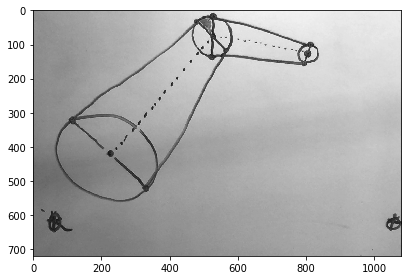

In [4]:
#@markdown Input color converted to grayscale
in_image = skimage.io.imread(in_file_name)
grayed_image = skimage.color.rgb2gray(in_image)
_ = skimage.io.imshow(grayed_image)

In [0]:
intensities_dist, bins_out = skimage.exposure.histogram(grayed_image, 256)
intensities_cdf, bins_out = skimage.exposure.cumulative_distribution(grayed_image, 256)


### Utilities

In [0]:
# A list 0, 1, 2, ..., 255. Used later as an X axis
eight_bit_range = np.arange(0, 256, 1)

### Whiteboarder class

In [0]:
from bokeh.events import DoubleTap
from bokeh.models.callbacks import CustomJS

class Whiteboarder:
  def gauge_small_bokeh(binned):
    """Returns a 200x124 pixel histogram. Param binned is the main output of 
       some histogramme; should be an array with len() == 256"""
    p = bokeh.plotting.figure(plot_width=256, plot_height=160, tools='box_zoom')
    p.toolbar.logo = None
    p.toolbar_location = None
    p.xaxis.visible = False
    p.yaxis.visible = False
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    p.x_range.range_padding = p.y_range.range_padding = 0
    # This next sets a double tap on image to reset zoom and pan
    p.js_on_event(DoubleTap, CustomJS(args=dict(p=p), code='p.reset.emit()'))
    p.vbar(x=eight_bit_range, width=1.0, bottom=0,
           top=binned, color='#404040')
    return p

# How to use:
# gauge = Whiteboarder.gauge_small_bokeh(an_intensities_distro)
# bokeh.plotting.show(gauge)

In [0]:
# TODO: this is just while building the class. No need after move to a package.
#add_image_and_histo_method = MethodType(add_image_and_histo, Whiteboarder)
@staticmethod
def image_small_bokeh(an_image, a_title):
  """an_image is a skimage gray image"""
  rgb = cv2.cvtColor(img_as_ubyte(an_image),cv2.COLOR_GRAY2RGB)
  rgba = cv2.cvtColor(rgb, cv2.COLOR_RGB2RGBA)
  rgba_flipped = rgba[::-1, :]

  p = bokeh.plotting.figure(plot_width=256, plot_height=160, tools='box_zoom', title=a_title)
  #img_plot.image(image=[grayed_image], x=[0], y=[0], dw=[1080], dh=[720]) #, palette="Spectral11", level="image")
  da_image = p.image_rgba(image=[rgba_flipped], x=[0], y=[0], dw=[1080], dh=[720]) #, palette="Spectral11", level="image"
  p.toolbar.logo = None
  p.toolbar_location = None
  p.xaxis.visible = False
  p.yaxis.visible = False
  p.x_range.range_padding = p.y_range.range_padding = 0
  #p.sizing_mode = 'stretch_both'
  return p
Whiteboarder.image_small_bokeh = image_small_bokeh

In [0]:
#@title Large image viewer
def image_viewer_bokeh_large(an_rgb_image):
  p = bokeh.plotting.figure(plot_width=1080, plot_height=720,
                            #title='Pixels by Intensity [by Bokeh]', 
                            #background_fill_color="#fafafa", 
                            x_range=(0,1080), 
                            y_range=(0,720))
  #p.sizing_mode = 'scale_both'
  p.toolbar.logo = None

  # TODO: maintain aspect ratio in full-screen. Is this a bug in Plotly?
  # https://docs.bokeh.org/en/latest/docs/user_guide/layout.html#modes
  p.sizing_mode = 'scale_both'

  #print(in_file_name)
  #logo_src = ColumnDataSource(dict(url = [in_file_name]))

  # grayed_flipped = grayed_image[::-1, :]
  # ready_to_go = img_as_ubyte(grayed_flipped)
  # works: p.image(image=[ready_to_go], x=[0], y=[0], dw=[1080], dh=[720]) #, palette="Spectral11", level="image")

  rgba = cv2.cvtColor(an_rgb_image, cv2.COLOR_RGB2RGBA)
  rgba_flipped = rgba[::-1, :]
  p.image_rgba(image=[rgba_flipped], x=[0], y=[0], dw=[1080], dh=[720]) #, palette="Spectral11", level="image")
  return p

## Thresholding


<a href="https://www.norwegiancreations.com/2016/03/arduino-tutorial-simple-high-pass-band-pass-and-band-stop-filtering/"><img src="https://www.norwegiancreations.com/wp-content/uploads/2016/03/filters.png" /></a>

### Low-pass filter


<img src="https://homepages.inf.ed.ac.uk/rbf/HIPR2/thrshb.gif" />

In [10]:
#@title { run: "auto" }
Threshold = 110 #@param {type:"slider", min:0, max:255, step:1}
threshold = Threshold / 256

low_pass_mask = grayed_image < threshold 
low_pass_mask_inverted = np.invert(low_pass_mask)

# Original
gauge = Whiteboarder.gauge_small_bokeh(intensities_dist)
small_image = Whiteboarder.image_small_bokeh(grayed_image, 'Original')
bokeh.plotting.show(bokeh.layouts.row(small_image, gauge))

# Thresholded
small_image = Whiteboarder.image_small_bokeh(low_pass_mask_inverted, f'Thresholded mask')
bokeh.plotting.show(bokeh.layouts.row(small_image))

In [11]:
#@markdown Low-pass masked input image
# Via https://stackoverflow.com/questions/54065119/intersect-image-with-mask-in-skimage
masked_image = np.copy(in_image)
masked_image[~low_pass_mask] = [255, 255, 255]

# too small: _ = skimage.io.imshow(masked_image)
plot = image_viewer_bokeh_large(masked_image)
bokeh.plotting.show(plot) 

### Band-pass filter

The output should have tree segments:
1. Low: forced to Black
3. Mid: original, not stretched
2. High:forced to White

Assuming (intuitively) that high_pass_threshold <= low_pass_threshold, a band-pass filter outputs any pixel where: 
```
(intensity >= high_pass_threshold) && (intensity <= low_pass_threshold)
```


Band-pass by definition does not involve constrast stretching, although that will be done later in more sophisticated version of this tool i.e. band-passing will continue to be used but as part of a more sophisticated image processing pipeline, such as Intensity Windowing.

The definition of band-pass is a bit abused here: a true band pass would set the blacks and white both equal to zero, whereas herein white is set to max not zero. (Doesn't matter, band-pass will not be in final tool.)

Above in "Brightness: alpha and beta" those two slider controls are independent of each other. Not so though for a band-pass range i.e. UI requires a single range input so that the high and low thresholds cannot get set swapped/inverted.

In [12]:
#@markdown Band-pass filter

import google.colab.output

low_pass_mask = None
high_pass_mask = None
band_pass_mask = None

# How to not override users choice every change
low_pass_threshold_in_ui = -1
high_pass_threshold_in_ui = -1
if low_pass_threshold_in_ui == -1:
  # ... it's uninited  
  low_pass_threshold_in_ui = 105
if high_pass_threshold_in_ui == 0:
  # ... it's uninited  
  high_pass_threshold_in_ui = 40

def on_band_slider_event(an_event): #, max, other):
  global high_pass_threshold_in_ui
  global low_pass_threshold_in_ui
  global band_pass_mask
  
  if an_event.type == 'change' and an_event.name == 'value':
    #print(an_event)
    grid.clear_cell(1,0)
    #print(f'change: {an_event.new} => {an_event.new}')
    high_pass_threshold_in_ui = an_event['new'][0]
    low_pass_threshold_in_ui = an_event['new'][1]
    #google.colab.output.clear()
    perform_band_pass()

band_slider = ipywidgets.IntRangeSlider(
  value=(high_pass_threshold_in_ui, low_pass_threshold_in_ui),
  min=0, max=255, step=1,
  continuous_update=False, # TODO: play with this
#  description='Band:',
  readout_format='d',
  layout=Layout(width='330px')#, height='50px')
  )
band_slider.observe(on_band_slider_event)

def perform_band_pass():
  global low_pass_mask
  global high_pass_mask
  global grid

  high_pass_threshold = high_pass_threshold_in_ui/256
  low_pass_threshold = low_pass_threshold_in_ui/256

  #print(f'high_pass_threshold = {high_pass_threshold}')
  #print(f'low_pass_threshold = {low_pass_threshold}')

  low_pass_mask = grayed_image < low_pass_threshold
  #low_pass_mask_inverted = np.invert(low_pass_mask)
  high_pass_mask = grayed_image > high_pass_threshold

  #band_passed_mask = np.full(grayed_image.shape, False)
  #band_passed_mask[low_pass_mask] = True
  #band_passed_mask[high_pass_mask] = True

  #band_pass_mask = (high_pass_threshold < grayed_image) and (grayed_image < low_pass_threshold)
  band_pass_mask = low_pass_mask & high_pass_mask

  #low_pass_mask_inverted = np.invert(low_pass_mask)
  #high_pass_mask = grayed_image > high_pass_threshold

  #band_passed_mask[band_pass_mask] = True
  small_image = Whiteboarder.image_small_bokeh(band_pass_mask, 'Band-passed')
  with grid.output_to(1, 0):
    grid.clear_cell(1,0)
    # Band-passed
    #print('b-p row')
    bokeh.plotting.show(small_image)
  
grid = google.colab.widgets.Grid(2, 2, style='border:none') 
# Input image:
with grid.output_to(0, 0):
  small_image = Whiteboarder.image_small_bokeh(grayed_image, 'Original')
  bokeh.plotting.show(small_image)
# Histogram:
with grid.output_to(0,1):
  print('\n')
  gauge = Whiteboarder.gauge_small_bokeh(intensities_dist)
  bokeh.plotting.show(gauge)
  display(band_slider)

perform_band_pass()

# TODO: add a spinner?

,
,


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

IntRangeSlider(value=(0, 105), continuous_update=False, layout=Layout(width='330px'), max=255)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [13]:
#@markdown Band-pass masked input image
# Via https://stackoverflow.com/questions/54065119/intersect-image-with-mask-in-skimage
masked_image = np.copy(in_image)
masked_image[~low_pass_mask] = [255, 255, 255]
masked_image[~high_pass_mask] = [0, 0, 0]



# too small: _ = skimage.io.imshow(masked_image)
plot = image_viewer_bokeh_large(masked_image)
bokeh.plotting.show(plot) 